In [1]:
!pip install EMD-signal

In [2]:
!pip install scipy

In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [51]:
from PyEMD import EMD
from scipy.signal import hilbert
import concurrent.futures

In [52]:
df=pd.read_csv("inc_resampled_dataset.csv")

In [53]:
df.head()

,0,1,2,3,4,5,6,7,8,9,...,171,172,173,174,175,176,177,178,179,target
0,0.001399,-0.009637,-0.014483,-0.008217,0.003079,0.009108,0.006485,0.001058,-0.000345,0.002199,...,0.016842,0.020552,0.027698,0.034403,0.034483,0.027981,0.021803,0.021277,0.023957,0
1,-0.003450,-0.000507,0.007082,0.008675,0.000749,-0.007706,-0.006197,0.004054,0.011627,0.008940,...,-0.015202,0.000804,0.012121,0.011672,0.005584,0.004995,0.012480,0.020793,0.023928,0
2,-0.009487,-0.009848,-0.003642,-0.001382,-0.004602,-0.003511,0.009169,0.027220,0.037831,0.036531,...,0.121585,0.132136,0.149422,0.175916,0.206855,0.226794,0.221882,0.198265,0.181316,0
3,-0.033187,-0.039688,-0.035787,-0.023284,-0.017343,-0.025122,-0.036150,-0.034832,-0.019275,-0.004171,...,0.033417,0.026292,0.019084,0.007791,-0.003452,-0.006242,0.001555,0.012435,0.017095,0
4,-0.042631,-0.055215,-0.044489,-0.011118,0.020328,0.021075,-0.011683,-0.049862,-0.063069,-0.046808,...,0.033473,0.053263,0.071243,0.069895,0.047216,0.019986,0.007720,0.013408,0.024234,0


In [54]:
df.shape

(50000, 181)

In [55]:
sampling_rate = 1000  # Hz

selected_data=df.iloc[:50001,:]

In [56]:
selected_data.head()

,0,1,2,3,4,5,6,7,8,9,...,171,172,173,174,175,176,177,178,179,target
0,0.001399,-0.009637,-0.014483,-0.008217,0.003079,0.009108,0.006485,0.001058,-0.000345,0.002199,...,0.016842,0.020552,0.027698,0.034403,0.034483,0.027981,0.021803,0.021277,0.023957,0
1,-0.003450,-0.000507,0.007082,0.008675,0.000749,-0.007706,-0.006197,0.004054,0.011627,0.008940,...,-0.015202,0.000804,0.012121,0.011672,0.005584,0.004995,0.012480,0.020793,0.023928,0
2,-0.009487,-0.009848,-0.003642,-0.001382,-0.004602,-0.003511,0.009169,0.027220,0.037831,0.036531,...,0.121585,0.132136,0.149422,0.175916,0.206855,0.226794,0.221882,0.198265,0.181316,0
3,-0.033187,-0.039688,-0.035787,-0.023284,-0.017343,-0.025122,-0.036150,-0.034832,-0.019275,-0.004171,...,0.033417,0.026292,0.019084,0.007791,-0.003452,-0.006242,0.001555,0.012435,0.017095,0
4,-0.042631,-0.055215,-0.044489,-0.011118,0.020328,0.021075,-0.011683,-0.049862,-0.063069,-0.046808,...,0.033473,0.053263,0.071243,0.069895,0.047216,0.019986,0.007720,0.013408,0.024234,0


In [57]:
selected_data.drop('target',axis=1,inplace=True)

C:\Users\sesid\AppData\Local\Temp\ipykernel_300\3561901364.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  selected_data.drop('target',axis=1,inplace=True)


In [58]:
selected_data.tail()

,0,1,2,3,4,5,6,7,8,9,...,170,171,172,173,174,175,176,177,178,179
49995,0.030782,0.026286,0.014514,0.002616,0.003375,0.021620,0.047828,0.065020,0.061461,0.038680,...,0.022143,0.019646,0.016341,0.012761,0.009145,0.005197,0.000819,-0.002830,-0.003779,-0.001538
49996,-0.024286,-0.013391,-0.001422,0.010504,0.020622,0.028529,0.036472,0.047367,0.061216,0.074663,...,0.251572,0.229817,0.213286,0.201282,0.189376,0.174650,0.158804,0.145617,0.136434,0.129301
49997,0.008225,0.006198,0.014466,0.035471,0.061054,0.080237,0.089421,0.093381,0.097741,0.103458,...,0.090448,0.069769,0.053919,0.039875,0.024639,0.009771,-0.001079,-0.007915,-0.014963,-0.025095
49998,0.004650,-0.001915,-0.017357,-0.004246,0.049233,0.107382,0.124376,0.096365,0.062125,0.055764,...,0.091072,0.059227,0.025858,0.005404,0.001323,0.001407,-0.008529,-0.027845,-0.041176,-0.036162
49999,0.173845,0.202601,0.244779,0.289296,0.318261,0.321911,0.312723,0.316602,0.345769,0.386824,...,0.352104,0.321524,0.275534,0.218849,0.170813,0.139568,0.112855,0.076657,0.034541,0.003529


In [59]:
sampling_rate = 1000

In [60]:
selected_data.shape

(50000, 180)

In [61]:
def hilbert_transform(imfs, sampling_rate):
    analytical_signal = hilbert(imfs)
    amplitude_envelope = np.abs(analytical_signal)
    instantaneous_phase = np.unwrap(np.angle(analytical_signal))
    instantaneous_frequency = (np.diff(instantaneous_phase) / (2.0 * np.pi) * sampling_rate)
    return amplitude_envelope, instantaneous_frequency

In [62]:
def process_row(row_index, row, sampling_rate):
    try:
        signal = row.values
        emd = EMD()
        imfs = emd(signal)
        num_imfs = len(imfs)
        row_results = []
        for imf in imfs:
            amplitude_envelope, instantaneous_frequency = hilbert_transform(imf, sampling_rate)
            row_results.append({
                "imf": imf,
                "amplitude_envelope": amplitude_envelope,
                "instantaneous_frequency": instantaneous_frequency
            })
        return row_index, num_imfs, row_results
    except Exception as e:
        print(f"Error processing row {row_index}: {e}")
        return row_index, 0, []

In [63]:
hvd_results = []
with concurrent.futures.ThreadPoolExecutor() as executor:
    # Submit tasks
    futures = {executor.submit(process_row, index, row, sampling_rate): index for index, row in selected_data.iterrows()}
    for future in concurrent.futures.as_completed(futures):
        try:
            row_index, num_imfs, row_results = future.result()
            hvd_results.append((row_index, num_imfs, row_results))
        except Exception as e:
            print(f"Error in future result: {e}")

In [64]:
# Sort results by row index (optional)
hvd_results.sort(key=lambda x: x[0])

# Print results for verification and plot IMFs
for row_index, num_imfs, row_results in hvd_results:
    print(f"Row {row_index} has {num_imfs} IMFs")

    #Plot the IMFs for the current row
    # plt.figure()
    # num_plots = num_imfs * 3
    # for i, result in enumerate(row_results):
    #     imf = result["imf"]
    #     amplitude_envelope = result["amplitude_envelope"]
    #     instantaneous_frequency = result["instantaneous_frequency"]
        
    #     plt.subplot(num_plots, 1, 3 * i + 1)
    #     plt.plot(imf)
    #     plt.title(f"Row {row_index} - IMF {i + 1}")

    #     plt.subplot(num_plots, 1, 3 * i + 2)
    #     plt.plot(amplitude_envelope)
    #     plt.title(f"Row {row_index} - IMF {i + 1} Amplitude Envelope")

    #     plt.subplot(num_plots, 1, 3 * i + 3)
    #     plt.plot(instantaneous_frequency)
    #     plt.title(f"Row {row_index} - IMF {i + 1} Instantaneous Frequency")

    # plt.tight_layout()
    # plt.show()

Row 0 has 6 IMFs
Row 1 has 6 IMFs
Row 2 has 5 IMFs
Row 3 has 5 IMFs
Row 4 has 5 IMFs
Row 5 has 5 IMFs
Row 6 has 5 IMFs
Row 7 has 5 IMFs
Row 8 has 5 IMFs
Row 9 has 5 IMFs
Row 10 has 5 IMFs
Row 11 has 5 IMFs
Row 12 has 5 IMFs
Row 13 has 6 IMFs
Row 14 has 5 IMFs
Row 15 has 4 IMFs
Row 16 has 5 IMFs
Row 17 has 4 IMFs
Row 18 has 4 IMFs
Row 19 has 5 IMFs
Row 20 has 4 IMFs
Row 21 has 5 IMFs
Row 22 has 4 IMFs
Row 23 has 5 IMFs
Row 24 has 5 IMFs
Row 25 has 5 IMFs
Row 26 has 4 IMFs
Row 27 has 4 IMFs
Row 28 has 5 IMFs
Row 29 has 5 IMFs
Row 30 has 4 IMFs
Row 31 has 5 IMFs
Row 32 has 5 IMFs
Row 33 has 5 IMFs
Row 34 has 5 IMFs
Row 35 has 5 IMFs
Row 36 has 5 IMFs
Row 37 has 5 IMFs
Row 38 has 5 IMFs
Row 39 has 5 IMFs
Row 40 has 5 IMFs
Row 41 has 5 IMFs
Row 42 has 4 IMFs
Row 43 has 5 IMFs
Row 44 has 6 IMFs
Row 45 has 4 IMFs
Row 46 has 5 IMFs
Row 47 has 5 IMFs
Row 48 has 5 IMFs
Row 49 has 5 IMFs
Row 50 has 5 IMFs
Row 51 has 5 IMFs
Row 52 has 5 IMFs
Row 53 has 5 IMFs
Row 54 has 5 IMFs
Row 55 has 5 IMFs
Ro

Row 46805 has 4 IMFs
Row 46806 has 5 IMFs
Row 46807 has 5 IMFs
Row 46808 has 5 IMFs
Row 46809 has 6 IMFs
Row 46810 has 4 IMFs
Row 46811 has 4 IMFs
Row 46812 has 5 IMFs
Row 46813 has 5 IMFs
Row 46814 has 5 IMFs
Row 46815 has 5 IMFs
Row 46816 has 4 IMFs
Row 46817 has 4 IMFs
Row 46818 has 4 IMFs
Row 46819 has 5 IMFs
Row 46820 has 5 IMFs
Row 46821 has 5 IMFs
Row 46822 has 4 IMFs
Row 46823 has 4 IMFs
Row 46824 has 5 IMFs
Row 46825 has 5 IMFs
Row 46826 has 4 IMFs
Row 46827 has 5 IMFs
Row 46828 has 5 IMFs
Row 46829 has 5 IMFs
Row 46830 has 5 IMFs
Row 46831 has 4 IMFs
Row 46832 has 5 IMFs
Row 46833 has 4 IMFs
Row 46834 has 5 IMFs
Row 46835 has 4 IMFs
Row 46836 has 5 IMFs
Row 46837 has 4 IMFs
Row 46838 has 4 IMFs
Row 46839 has 5 IMFs
Row 46840 has 5 IMFs
Row 46841 has 5 IMFs
Row 46842 has 4 IMFs
Row 46843 has 4 IMFs
Row 46844 has 6 IMFs
Row 46845 has 4 IMFs
Row 46846 has 6 IMFs
Row 46847 has 6 IMFs
Row 46848 has 5 IMFs
Row 46849 has 5 IMFs
Row 46850 has 5 IMFs
Row 46851 has 5 IMFs
Row 46852 has

C:\Users\sesid\AppData\Local\Temp\ipykernel_300\1399398197.py:26: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  plt.tight_layout()


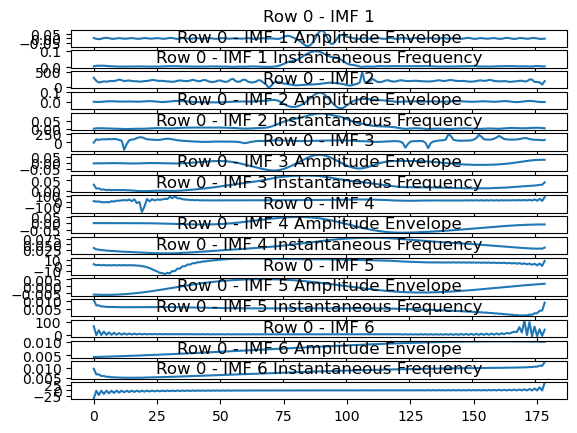

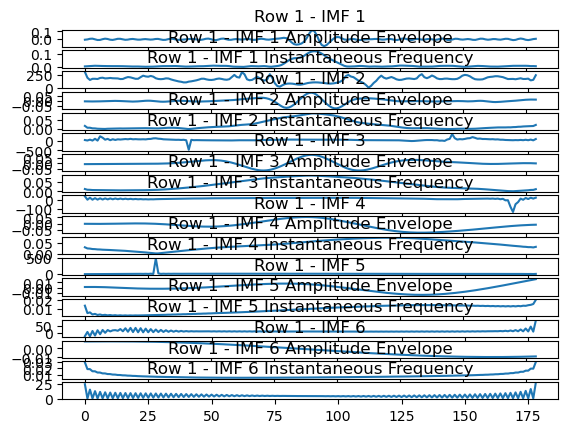

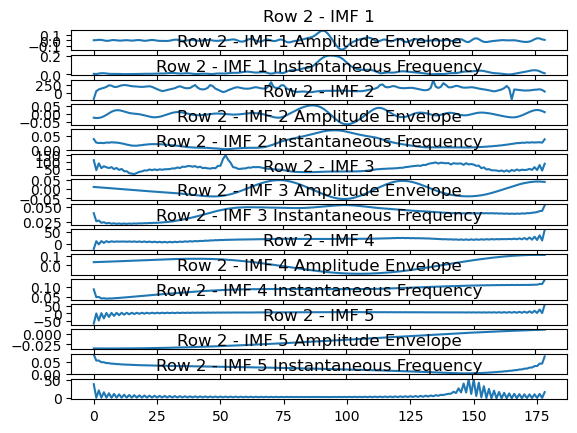

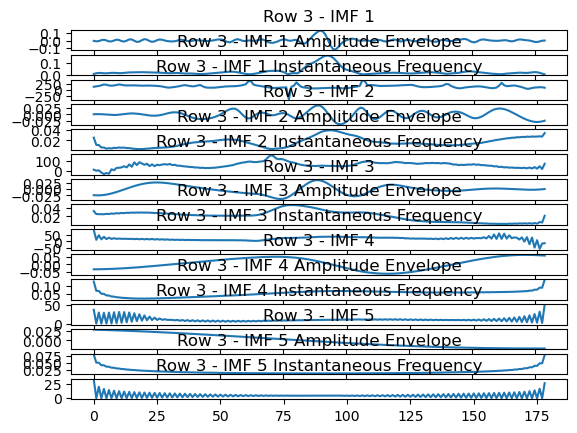

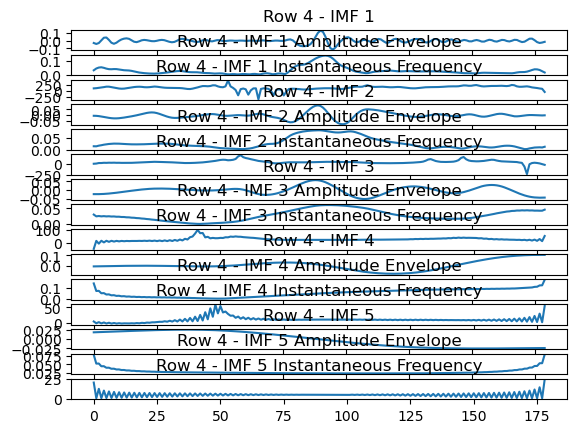

...

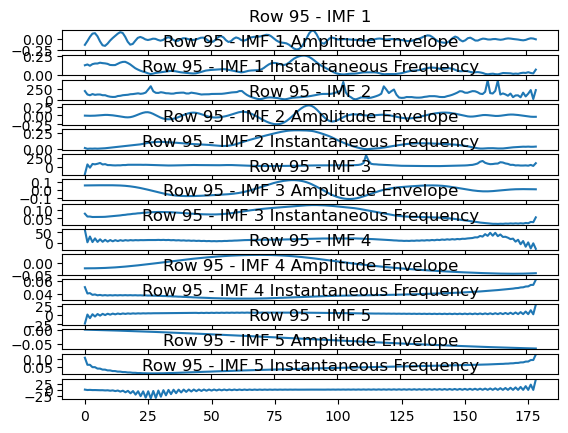

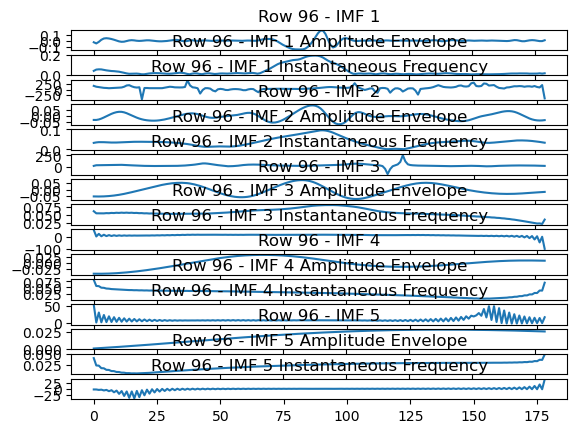

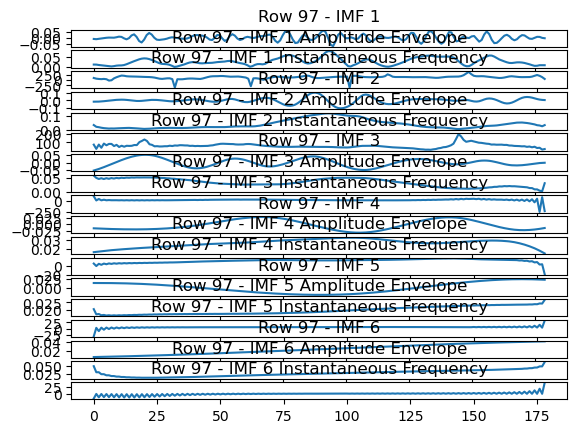

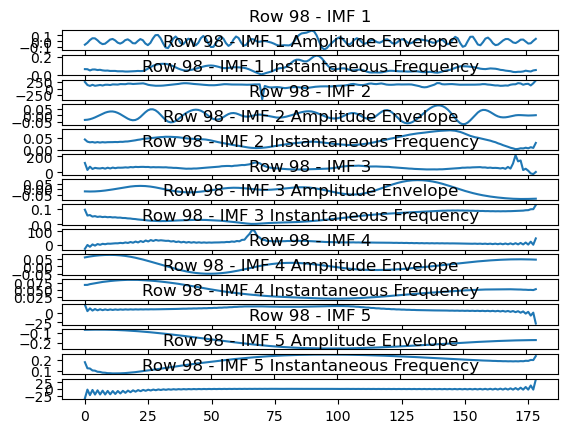

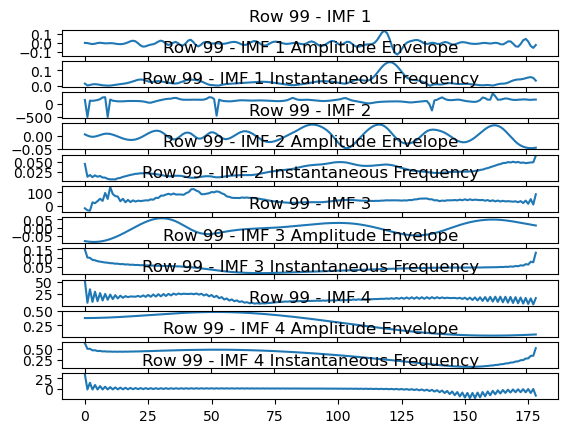

In [65]:
row_counter = 0

# Print results for verification and plot IMFs
for row_index, num_imfs, row_results in hvd_results:
    if row_counter >= 100:
        break  # Stop after processing 100 rows
    plt.figure()
    num_plots = num_imfs * 3
    for i, result in enumerate(row_results):
        imf = result["imf"]
        amplitude_envelope = result["amplitude_envelope"]
        instantaneous_frequency = result["instantaneous_frequency"]

        plt.subplot(num_plots, 1, 3 * i + 1)
        plt.plot(imf)
        plt.title(f"Row {row_index} - IMF {i + 1}")

        plt.subplot(num_plots, 1, 3 * i + 2)
        plt.plot(amplitude_envelope)
        plt.title(f"Row {row_index} - IMF {i + 1} Amplitude Envelope")

        plt.subplot(num_plots, 1, 3 * i + 3)
        plt.plot(instantaneous_frequency)
        plt.title(f"Row {row_index} - IMF {i + 1} Instantaneous Frequency")

    plt.tight_layout()
    plt.show()

    row_counter += 1

In [66]:
import numpy as np

def calculate_features(imf):
    energy = np.sum(np.square(imf))
    mean_val = np.mean(imf)
    variance = np.var(imf)
    amplitude = np.ptp(imf)  # Peak-to-peak (max-min)
    signal_to_noise_ratio = np.mean(np.abs(imf))/np.std(imf) if np.mean(np.abs(imf)) != 0 else np.inf
    return energy, mean_val, variance, amplitude, signal_to_noise_ratio


In [67]:
def normalize_features(features):
    # Avoid division by zero by using np.where
    mean_features = np.mean(features, axis=0)
    std_features = np.std(features, axis=0)
    std_features = np.where(std_features == 0, 1, std_features)
    normalized = (features - mean_features) / std_features
    return normalized, mean_features, std_features

In [68]:
def calculate_importance_score(normalized_features, weights=None):
    if weights is None:
        weights = np.ones(normalized_features.shape[1])
    importance_scores = np.dot(normalized_features, weights)
    return importance_scores

In [69]:
def select_important_imf(hvd_result):
    row_idx, num_imfs, imfs = hvd_result
    features_list = []
    
    for imf_dict in imfs:
        imf = imf_dict['imf']
        features = calculate_features(imf)
        features_list.append(features)
    
    features_array = np.array(features_list)
    normalized_features, mean_features, std_features = normalize_features(features_array)
    importance_scores = calculate_importance_score(normalized_features)
    
    most_important_imf_index = np.argmax(importance_scores)
    most_important_imf = imfs[most_important_imf_index]
    most_important_imf_features = features_array[most_important_imf_index]
    most_contributing_feature_index = np.argmax(normalized_features[most_important_imf_index])

    return most_important_imf_index, most_important_imf, most_contributing_feature_index

In [70]:
# Process all rows
important_imfs = []
for hvd_result in hvd_results:
    most_important_imf_index, most_important_imf, most_contributing_feature_index = select_important_imf(hvd_result)
    important_imfs.append((hvd_result[0], most_important_imf_index, most_important_imf, most_contributing_feature_index))

In [71]:
# Output the important IMFs and the most contributing feature
feature_names = ["Energy", "Mean", "Variance", "Amplitude", "Signal-Noise Ratio"]
for row, imf_index, imf, feature_index in important_imfs:
    print(f"Row {row + 1}: Most important IMF is IMF {imf_index + 1} based on {feature_names[feature_index]}")

Row 1: Most important IMF is IMF 4 based on Energy
Row 2: Most important IMF is IMF 3 based on Variance
Row 3: Most important IMF is IMF 4 based on Energy
Row 4: Most important IMF is IMF 4 based on Mean
Row 5: Most important IMF is IMF 4 based on Energy
Row 6: Most important IMF is IMF 3 based on Mean
Row 7: Most important IMF is IMF 3 based on Variance
Row 8: Most important IMF is IMF 4 based on Mean
Row 9: Most important IMF is IMF 3 based on Energy
Row 10: Most important IMF is IMF 4 based on Energy
Row 11: Most important IMF is IMF 5 based on Mean
Row 12: Most important IMF is IMF 5 based on Mean
Row 13: Most important IMF is IMF 1 based on Amplitude
Row 14: Most important IMF is IMF 3 based on Energy
Row 15: Most important IMF is IMF 3 based on Energy
Row 16: Most important IMF is IMF 2 based on Energy
Row 17: Most important IMF is IMF 3 based on Energy
Row 18: Most important IMF is IMF 3 based on Energy
Row 19: Most important IMF is IMF 2 based on Mean
Row 20: Most important IMF

In [72]:
import numpy as np

# Assuming hvd_results is your input list of tuples

def calculate_features(imf):
    energy = np.sum(np.square(imf))
    mean_val = np.mean(imf)
    variance = np.var(imf)
    amplitude = np.ptp(imf)  # Peak-to-peak (max-min)
    noise_to_signal_ratio = np.std(imf) / np.mean(np.abs(imf)) if np.mean(np.abs(imf)) != 0 else np.inf
    return energy, mean_val, variance, amplitude, noise_to_signal_ratio

def normalize_features(features):
    mean_features = np.mean(features, axis=0)
    std_features = np.std(features, axis=0)
    std_features = np.where(std_features == 0, 1, std_features)
    normalized = (features - mean_features) / std_features
    return normalized, mean_features, std_features

def calculate_importance_score(normalized_features, weights=None):
    if weights is None:
        weights = np.ones(normalized_features.shape[1])
    importance_scores = np.dot(normalized_features, weights)
    return importance_scores

def select_important_imf(hvd_result):
    row_idx, num_imfs, imfs = hvd_result
    features_list = []
    
    for imf_dict in imfs:
        imf = imf_dict['imf']
        features = calculate_features(imf)
        features_list.append(features)
    
    features_array = np.array(features_list)
    normalized_features, mean_features, std_features = normalize_features(features_array)
    importance_scores = calculate_importance_score(normalized_features)
    
    most_important_imf_index = np.argmax(importance_scores)
    most_important_imf = imfs[most_important_imf_index]
    most_important_imf_features = features_array[most_important_imf_index]
    most_contributing_feature_index = np.argmax(normalized_features[most_important_imf_index])

    return most_important_imf_index, most_important_imf, most_contributing_feature_index

# Process all rows to find the most important IMFs and the most contributing features
important_imfs = []
max_imfs = max([result[1] for result in hvd_results])
imf_count = np.zeros(max_imfs)  # Adjust the size according to the max number of IMFs
feature_count = np.zeros(5)  # There are 5 features

for hvd_result in hvd_results:
    most_important_imf_index, most_important_imf, most_contributing_feature_index = select_important_imf(hvd_result)
    important_imfs.append((hvd_result[0], most_important_imf_index, most_important_imf, most_contributing_feature_index))
    imf_count[most_important_imf_index] += 1
    feature_count[most_contributing_feature_index] += 1

# Print the counts
print("Count of important IMFs:")
for i in range(len(imf_count)):
    print(f"IMF {i + 1}: {int(imf_count[i])}")

print("\nCount of important features:")
feature_names = ["Energy", "Mean", "Variance", "Amplitude", "Noise-to-Signal Ratio"]
for i in range(len(feature_count)):
    print(f"{feature_names[i]}: {int(feature_count[i])}")


Count of important IMFs:
IMF 1: 13607
IMF 2: 15915
IMF 3: 14806
IMF 4: 5125
IMF 5: 542
IMF 6: 5
IMF 7: 0

Count of important features:
Energy: 13575
Mean: 4518
Variance: 13918
Amplitude: 12243
Noise-to-Signal Ratio: 5746


In [73]:
def calculate_energy(imf):
    energy =np.sum(np.square(imf))
    variance = np.var(imf)
    amplitude = np.ptp(imf) 
    return energy,variance,amplitude

important_imf_indices = []
for hvd_result in hvd_results:
    most_important_imf_index, _, _ = select_important_imf(hvd_result)
    important_imf_indices.append(most_important_imf_index)

# Step 2: Extract the energy values only for the important IMFs
energy_results = []
for row_index, (hvd_result, imf_index) in enumerate(zip(hvd_results, important_imf_indices)):
    imf = hvd_result[2][imf_index]['imf']
    energy,vaiance,amplitude = calculate_energy(imf)
    energy_results.append((row_index, energy ,vaiance,amplitude))

# Save the energy values in a CSV file
energy_df = pd.DataFrame(energy_results, columns=['Row Index', 'Energy','Variance', 'Amplitude'])
energy_df.to_csv('10inc_results.csv', index=False)

